In [1]:
import os
import random
import torch
import torchvision
import torch.nn as nn
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
from torch import optim

from tqdm import tqdm
from torchvision import transforms
from torchvision.utils import make_grid

import numpy as np
import matplotlib.pyplot as plt

In [2]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

device

'cuda'

In [3]:
from google.colab import drive

drive.mount("/content/drive")

Mounted at /content/drive


In [4]:
!unzip '/content/drive/MyDrive/celeb_faces/img_align_celeba.zip' -d'/content/celeb_faces'

Streaming output truncated to the last 5000 lines.
 extracting: /content/celeb_faces/img_align_celeba/197600.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197601.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197602.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197603.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197604.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197605.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197606.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197607.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197608.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197609.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197610.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197611.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197612.jpg  
 extracting: /content/celeb_faces/img_align_celeba/197613.jpg  
 extracting: /content/celeb_faces/img_align_celeba/19

In [5]:
batch_size = 128
image_size = 64

# Create the dataset
celeb_faces_dataset = dset.ImageFolder(
    root = '/content/celeb_faces/',
    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])
)

# Create the dataloader
train_dl = torch.utils.data.DataLoader(
    celeb_faces_dataset, batch_size = batch_size,
    shuffle = True, num_workers = 2, drop_last = True
)

len(train_dl)

1582

In [6]:
len(celeb_faces_dataset)

202599

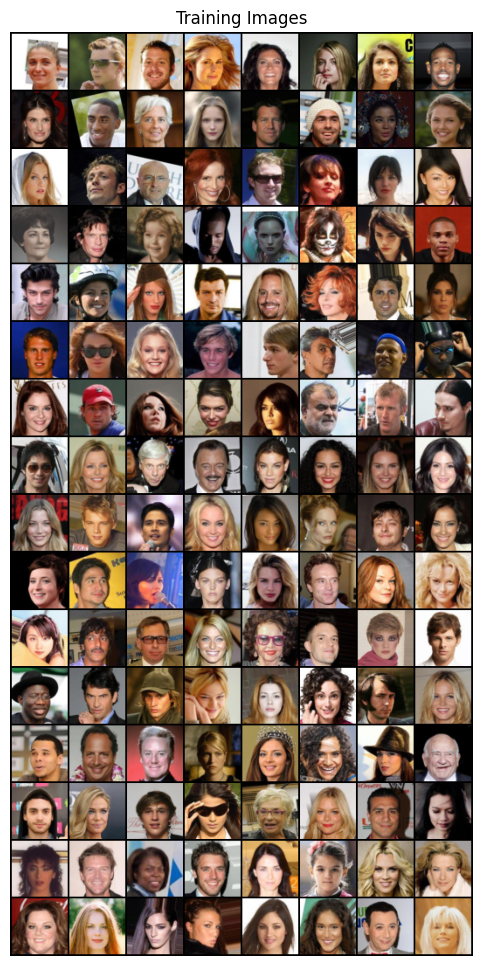

In [7]:
real_batch = next(iter(train_dl))

plt.figure(figsize = (20 , 12))
plt.axis('off')

plt.title('Training Images')
plt.imshow(np.transpose(
    make_grid(real_batch[0].to(device), padding = 2, normalize = True).cpu(),
     (1, 2, 0)
))
plt.show()

In [8]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [9]:
# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

In [10]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(
                in_channels = nz, out_channels = ngf * 8,
                kernel_size = 4, stride = 1, padding = 0, bias = False
            ),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4

            nn.ConvTranspose2d(
                in_channels = ngf * 8, out_channels = ngf * 4,
                kernel_size = 4, stride = 2, padding = 1, bias = False
            ),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8

            nn.ConvTranspose2d(
                in_channels = ngf * 4, out_channels = ngf * 2,
                kernel_size = 4, stride = 2, padding = 1, bias = False
            ),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``

            nn.ConvTranspose2d(
                in_channels = ngf * 2, out_channels = ngf,
                kernel_size = 4, stride = 2, padding = 1, bias = False
            ),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32

            nn.ConvTranspose2d(
                in_channels = ngf, out_channels = nc,
                kernel_size = 4, stride = 2, padding = 1, bias = False
            ),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, x):
        return self.main(x)

In [11]:
netG = Generator().to(device)

netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [12]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(
                in_channels = nc, out_channels = ndf,
                kernel_size = 4, stride = 2, padding = 1, bias = False
            ),
            nn.LeakyReLU(0.2, inplace = True),
            # state size (ndf) x 32 x 32

            nn.Conv2d(
                in_channels = ndf, out_channels = ndf * 2,
                kernel_size = 4, stride = 2, padding = 1, bias = False
            ),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace = True),
            # state size. (ndf*2) x 16 x 16

            nn.Conv2d(
                in_channels = ndf * 2, out_channels = ndf * 4,
                kernel_size = 4, stride = 2, padding = 1, bias = False
            ),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace = True),
            # state size. (ndf*4) x 8 x 8

            nn.Conv2d(
                in_channels = ndf * 4, out_channels = ndf * 8,
                kernel_size = 4, stride = 2, padding = 1, bias = False
            ),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace = True),
            # state size. (ndf*8) x 4 x 4

            nn.Conv2d(
                in_channels = ndf * 8, out_channels = 1,
                kernel_size = 4, stride = 1, padding = 0, bias = False
            ),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.main(x)

In [13]:
netD = Discriminator().to(device)

netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [14]:
# Number of training epochs
num_epochs = 8

In [15]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device = device)

# Labels for real and fake data
real_image_labels = torch.full((batch_size,), 1., dtype = torch.float, device = device)
fake_image_labels = torch.full((batch_size,), 0., dtype = torch.float, device = device)

# Setup Adam optimizers for both G and D
optimizer_d = optim.Adam(netD.parameters(), lr = 0.0002, betas = (0.5, 0.999))
optimizer_g = optim.Adam(netG.parameters(), lr = 0.0002, betas = (0.5, 0.999))

In [16]:
def display(img):
    plt.figure(figsize = (6, 6))
    img = img / 2 + 0.5
    img = img.permute(1, 2, 0)
    npimg = img.numpy()

    plt.imshow(npimg)
    plt.xticks([])
    plt.yticks([])
    plt.show()

  0%|          | 0/8 [00:00<?, ?it/s]

-------------------------------------
                Epoch 1: Step: 0 |
                D_real Loss: 0.5598 | D_fake Loss: 0.5706 |
                D_total Loss: 1.1303 | G_Loss: 5.666 |
                Real_score 0.606 | Fake_score 0.401
            


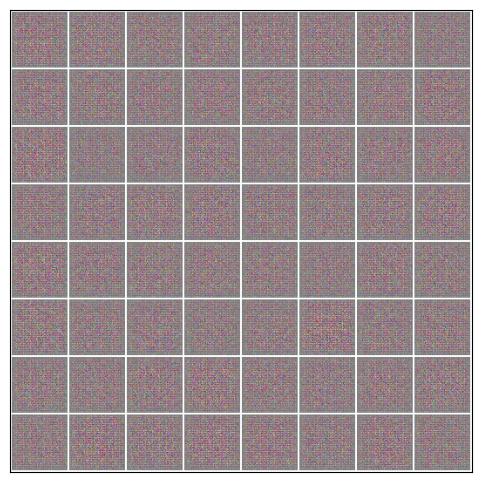

-------------------------------------
                Epoch 1: Step: 200 |
                D_real Loss: 0.2993 | D_fake Loss: 0.0667 |
                D_total Loss: 0.3660 | G_Loss: 4.807 |
                Real_score 0.788 | Fake_score 0.063
            


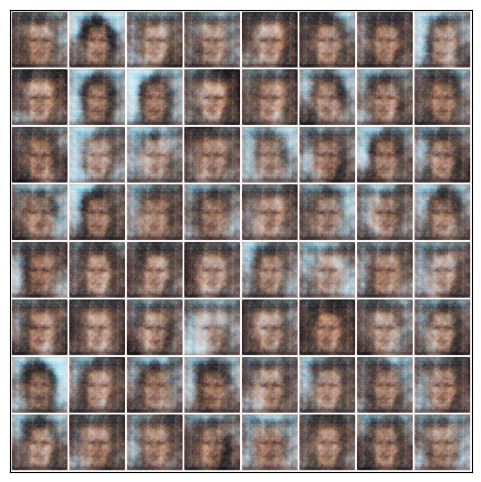

-------------------------------------
                Epoch 1: Step: 400 |
                D_real Loss: 0.2136 | D_fake Loss: 0.3978 |
                D_total Loss: 0.6114 | G_Loss: 4.022 |
                Real_score 0.844 | Fake_score 0.299
            


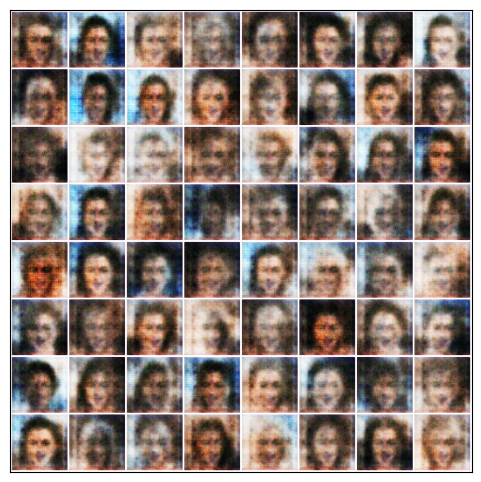

-------------------------------------
                Epoch 1: Step: 600 |
                D_real Loss: 0.3730 | D_fake Loss: 0.1149 |
                D_total Loss: 0.4879 | G_Loss: 3.907 |
                Real_score 0.763 | Fake_score 0.099
            


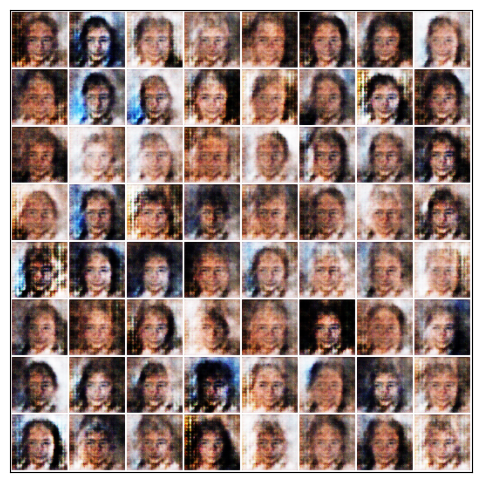

-------------------------------------
                Epoch 1: Step: 800 |
                D_real Loss: 0.4270 | D_fake Loss: 0.1466 |
                D_total Loss: 0.5736 | G_Loss: 3.153 |
                Real_score 0.729 | Fake_score 0.124
            


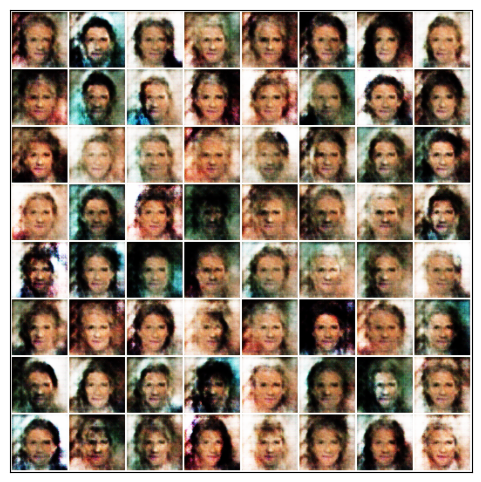

-------------------------------------
                Epoch 1: Step: 1000 |
                D_real Loss: 0.0858 | D_fake Loss: 0.7491 |
                D_total Loss: 0.8349 | G_Loss: 6.703 |
                Real_score 0.927 | Fake_score 0.452
            


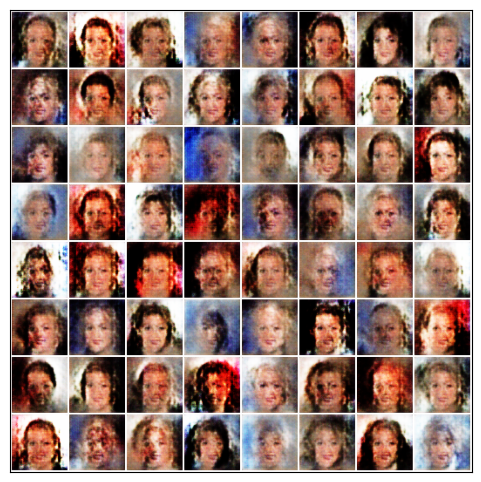

-------------------------------------
                Epoch 1: Step: 1200 |
                D_real Loss: 0.2407 | D_fake Loss: 0.4662 |
                D_total Loss: 0.7068 | G_Loss: 5.844 |
                Real_score 0.816 | Fake_score 0.344
            


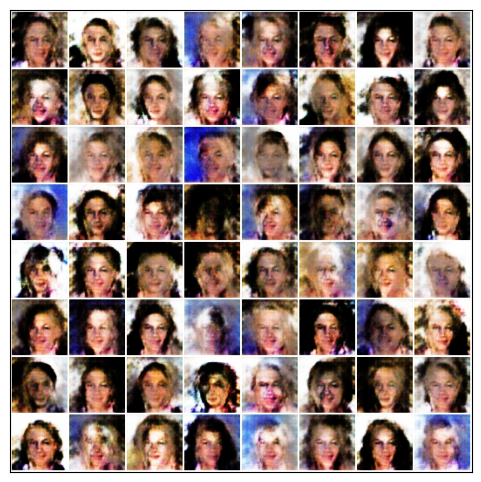

-------------------------------------
                Epoch 1: Step: 1400 |
                D_real Loss: 0.2168 | D_fake Loss: 0.3115 |
                D_total Loss: 0.5283 | G_Loss: 4.178 |
                Real_score 0.836 | Fake_score 0.230
            


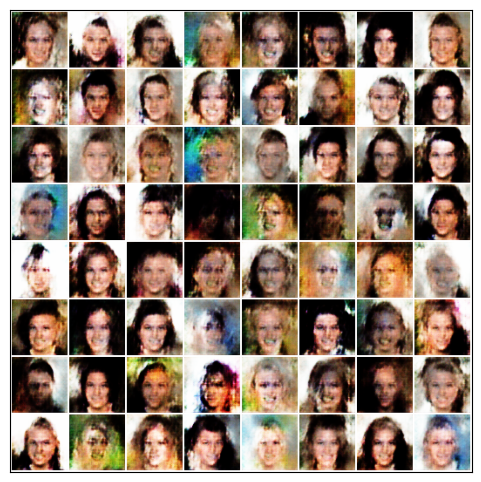

 12%|█▎        | 1/8 [05:50<40:52, 350.37s/it]

-------------------------------------
                Epoch 2: Step: 0 |
                D_real Loss: 0.3604 | D_fake Loss: 0.0852 |
                D_total Loss: 0.4457 | G_Loss: 3.039 |
                Real_score 0.734 | Fake_score 0.077
            


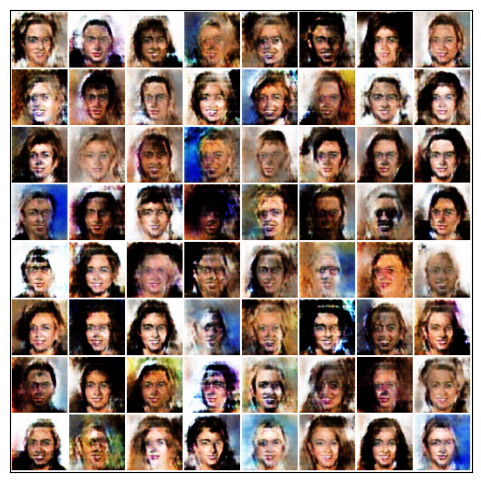

-------------------------------------
                Epoch 2: Step: 200 |
                D_real Loss: 0.1906 | D_fake Loss: 0.0926 |
                D_total Loss: 0.2832 | G_Loss: 2.709 |
                Real_score 0.854 | Fake_score 0.083
            


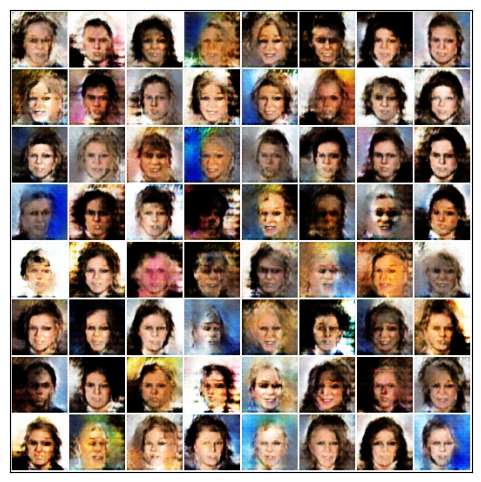

-------------------------------------
                Epoch 2: Step: 400 |
                D_real Loss: 0.0794 | D_fake Loss: 0.4263 |
                D_total Loss: 0.5057 | G_Loss: 5.524 |
                Real_score 0.929 | Fake_score 0.310
            


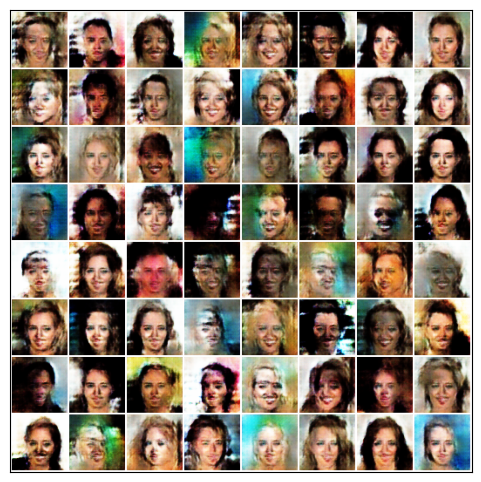

-------------------------------------
                Epoch 2: Step: 600 |
                D_real Loss: 0.1357 | D_fake Loss: 0.2413 |
                D_total Loss: 0.3770 | G_Loss: 4.651 |
                Real_score 0.887 | Fake_score 0.197
            


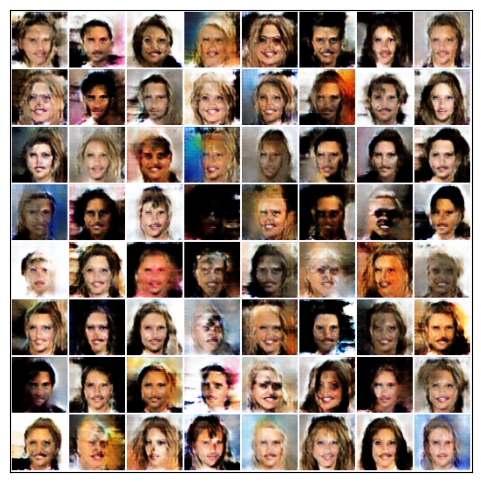

-------------------------------------
                Epoch 2: Step: 800 |
                D_real Loss: 0.0992 | D_fake Loss: 0.2540 |
                D_total Loss: 0.3532 | G_Loss: 3.494 |
                Real_score 0.920 | Fake_score 0.200
            


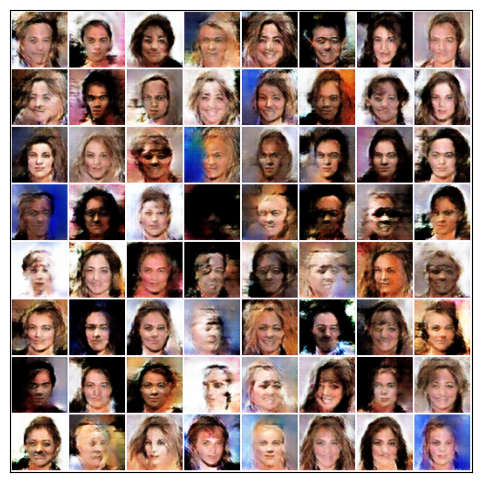

-------------------------------------
                Epoch 2: Step: 1000 |
                D_real Loss: 0.6574 | D_fake Loss: 0.0806 |
                D_total Loss: 0.7380 | G_Loss: 1.531 |
                Real_score 0.583 | Fake_score 0.073
            


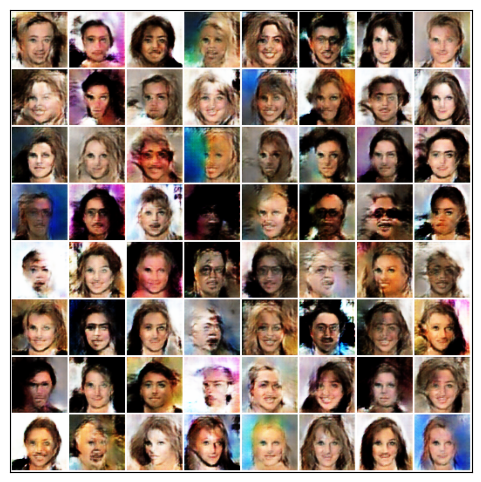

-------------------------------------
                Epoch 2: Step: 1200 |
                D_real Loss: 0.2464 | D_fake Loss: 0.2487 |
                D_total Loss: 0.4950 | G_Loss: 3.033 |
                Real_score 0.805 | Fake_score 0.200
            


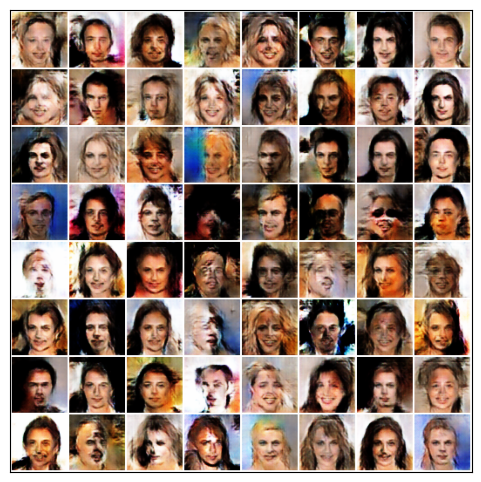

-------------------------------------
                Epoch 2: Step: 1400 |
                D_real Loss: 0.2815 | D_fake Loss: 0.0928 |
                D_total Loss: 0.3743 | G_Loss: 2.794 |
                Real_score 0.775 | Fake_score 0.084
            


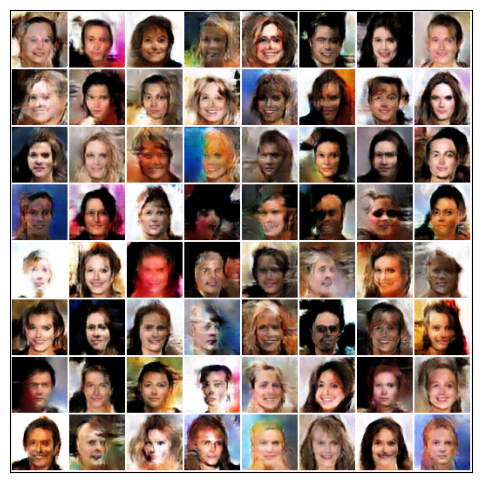

 25%|██▌       | 2/8 [11:37<34:50, 348.48s/it]

-------------------------------------
                Epoch 3: Step: 0 |
                D_real Loss: 0.1085 | D_fake Loss: 0.1572 |
                D_total Loss: 0.2657 | G_Loss: 3.946 |
                Real_score 0.902 | Fake_score 0.135
            


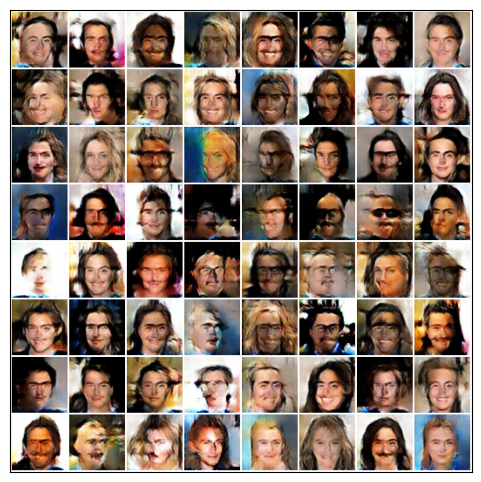

-------------------------------------
                Epoch 3: Step: 200 |
                D_real Loss: 0.0881 | D_fake Loss: 0.3492 |
                D_total Loss: 0.4372 | G_Loss: 3.623 |
                Real_score 0.919 | Fake_score 0.272
            


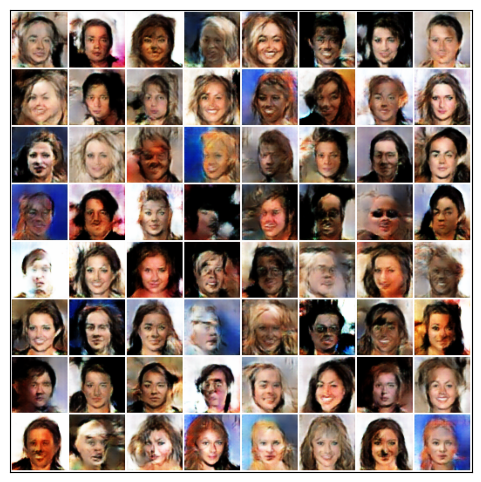

-------------------------------------
                Epoch 3: Step: 400 |
                D_real Loss: 0.1145 | D_fake Loss: 0.5282 |
                D_total Loss: 0.6427 | G_Loss: 3.286 |
                Real_score 0.901 | Fake_score 0.373
            


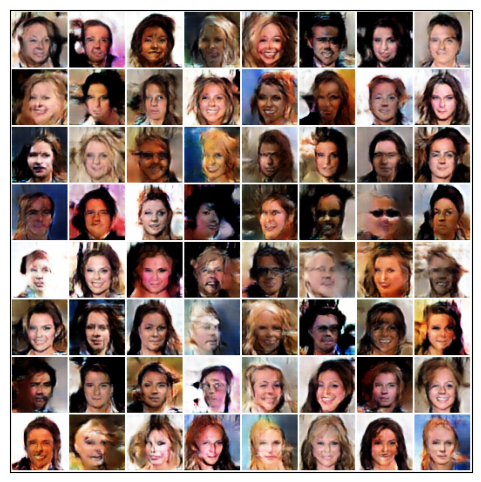

-------------------------------------
                Epoch 3: Step: 600 |
                D_real Loss: 0.1818 | D_fake Loss: 0.3186 |
                D_total Loss: 0.5004 | G_Loss: 2.862 |
                Real_score 0.843 | Fake_score 0.258
            


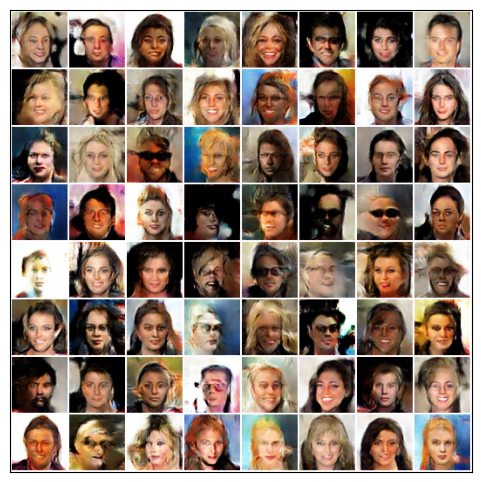

-------------------------------------
                Epoch 3: Step: 800 |
                D_real Loss: 0.3061 | D_fake Loss: 0.3641 |
                D_total Loss: 0.6702 | G_Loss: 3.173 |
                Real_score 0.762 | Fake_score 0.273
            


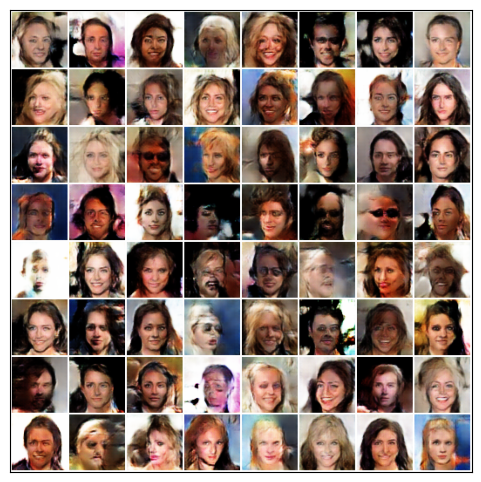

-------------------------------------
                Epoch 3: Step: 1000 |
                D_real Loss: 0.2837 | D_fake Loss: 0.2038 |
                D_total Loss: 0.4875 | G_Loss: 2.555 |
                Real_score 0.769 | Fake_score 0.171
            


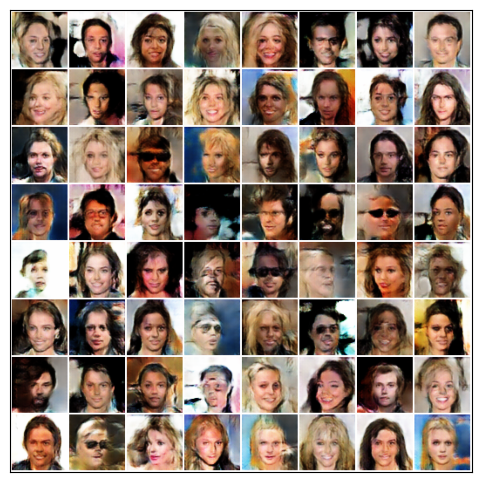

-------------------------------------
                Epoch 3: Step: 1200 |
                D_real Loss: 0.6013 | D_fake Loss: 0.0966 |
                D_total Loss: 0.6979 | G_Loss: 1.344 |
                Real_score 0.590 | Fake_score 0.089
            


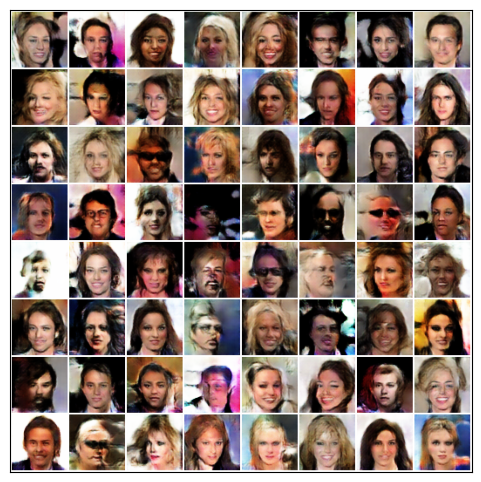

-------------------------------------
                Epoch 3: Step: 1400 |
                D_real Loss: 0.1630 | D_fake Loss: 0.4713 |
                D_total Loss: 0.6343 | G_Loss: 2.808 |
                Real_score 0.856 | Fake_score 0.347
            


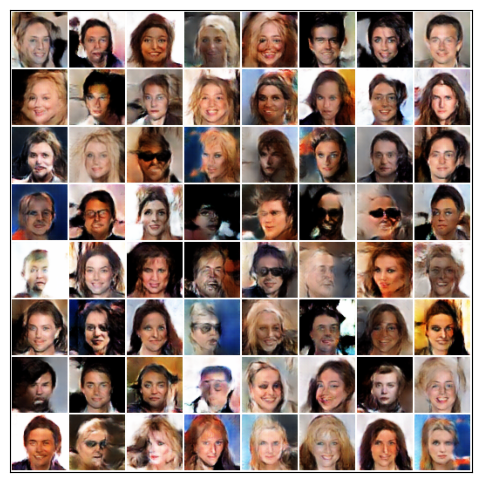

 38%|███▊      | 3/8 [17:25<29:00, 348.15s/it]

-------------------------------------
                Epoch 4: Step: 0 |
                D_real Loss: 0.2426 | D_fake Loss: 0.2541 |
                D_total Loss: 0.4967 | G_Loss: 2.572 |
                Real_score 0.802 | Fake_score 0.214
            


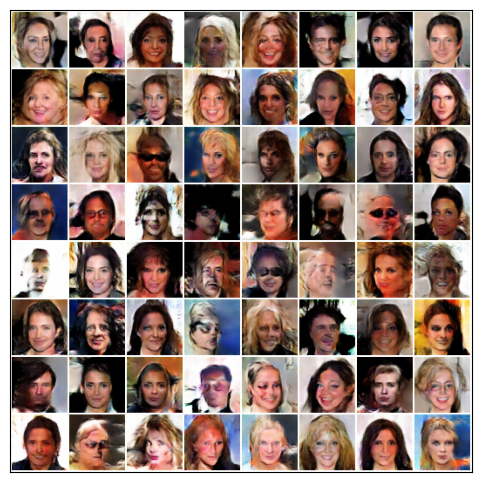

-------------------------------------
                Epoch 4: Step: 200 |
                D_real Loss: 0.1543 | D_fake Loss: 0.8571 |
                D_total Loss: 1.0114 | G_Loss: 3.144 |
                Real_score 0.873 | Fake_score 0.502
            


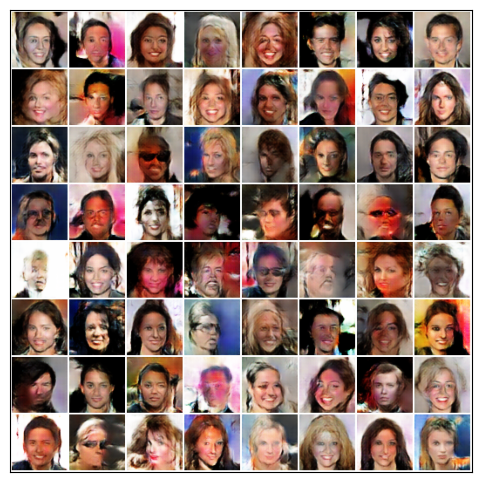

-------------------------------------
                Epoch 4: Step: 400 |
                D_real Loss: 0.3883 | D_fake Loss: 0.1427 |
                D_total Loss: 0.5309 | G_Loss: 1.994 |
                Real_score 0.704 | Fake_score 0.126
            


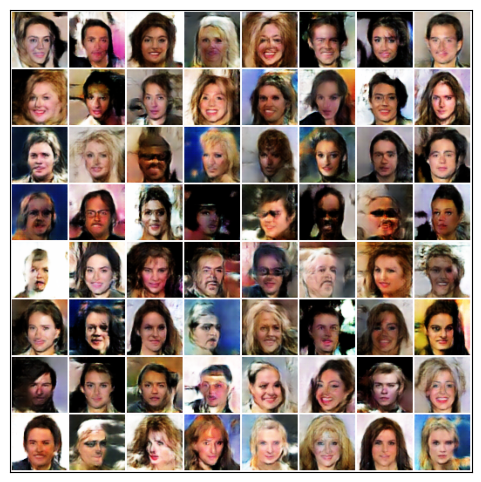

-------------------------------------
                Epoch 4: Step: 600 |
                D_real Loss: 0.2568 | D_fake Loss: 0.2588 |
                D_total Loss: 0.5157 | G_Loss: 2.251 |
                Real_score 0.789 | Fake_score 0.215
            


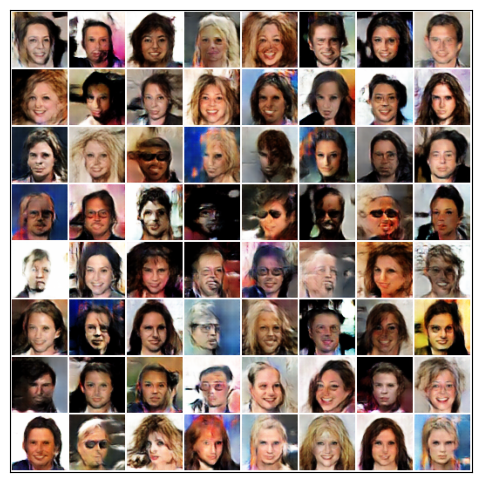

-------------------------------------
                Epoch 4: Step: 800 |
                D_real Loss: 0.1602 | D_fake Loss: 0.4149 |
                D_total Loss: 0.5751 | G_Loss: 3.449 |
                Real_score 0.862 | Fake_score 0.317
            


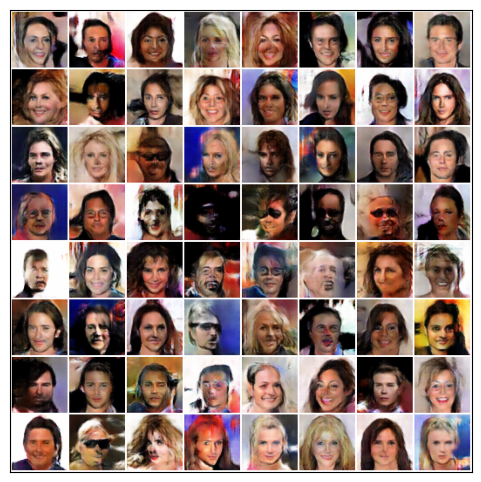

-------------------------------------
                Epoch 4: Step: 1000 |
                D_real Loss: 0.1508 | D_fake Loss: 0.4804 |
                D_total Loss: 0.6313 | G_Loss: 2.907 |
                Real_score 0.870 | Fake_score 0.349
            


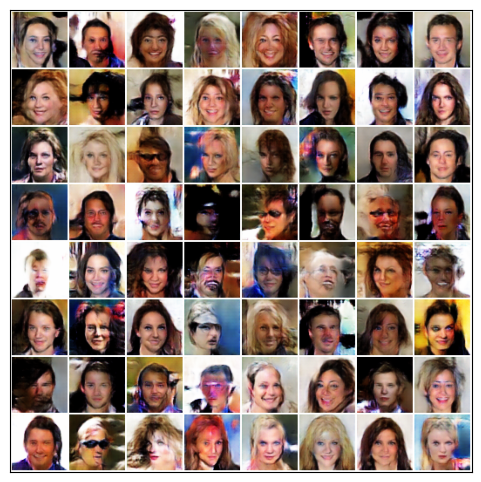

-------------------------------------
                Epoch 4: Step: 1200 |
                D_real Loss: 1.2674 | D_fake Loss: 0.0430 |
                D_total Loss: 1.3104 | G_Loss: 1.153 |
                Real_score 0.346 | Fake_score 0.041
            


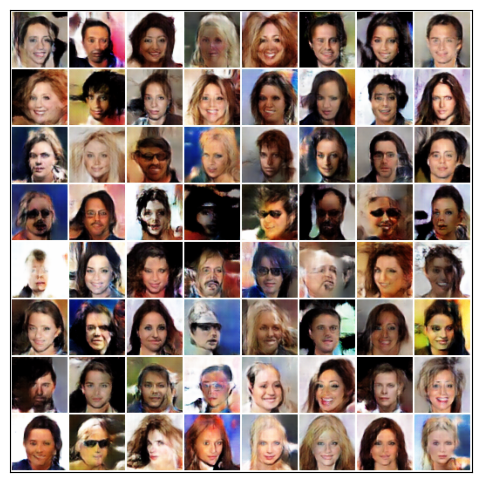

-------------------------------------
                Epoch 4: Step: 1400 |
                D_real Loss: 0.0350 | D_fake Loss: 0.8481 |
                D_total Loss: 0.8832 | G_Loss: 4.155 |
                Real_score 0.966 | Fake_score 0.529
            


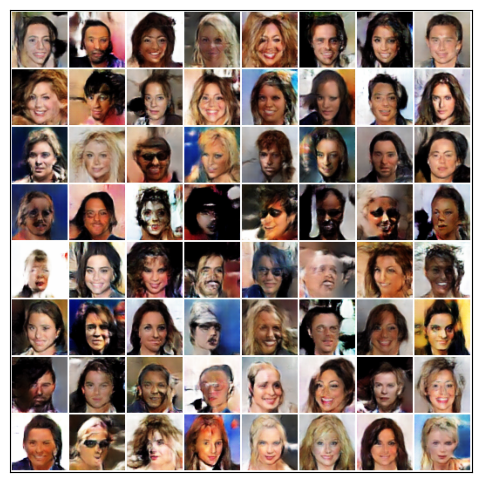

 50%|█████     | 4/8 [23:13<23:12, 348.01s/it]

-------------------------------------
                Epoch 5: Step: 0 |
                D_real Loss: 0.0475 | D_fake Loss: 1.7803 |
                D_total Loss: 1.8278 | G_Loss: 3.864 |
                Real_score 0.955 | Fake_score 0.788
            


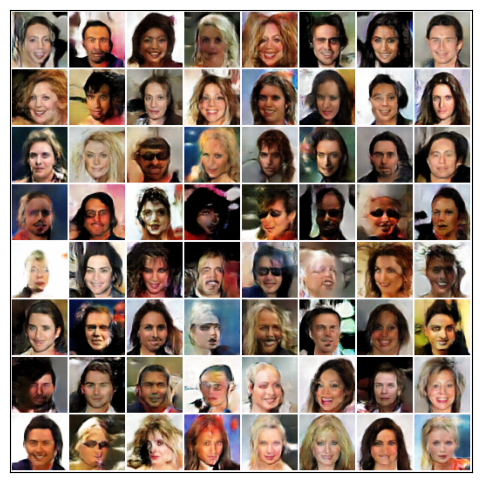

-------------------------------------
                Epoch 5: Step: 200 |
                D_real Loss: 0.3809 | D_fake Loss: 0.2097 |
                D_total Loss: 0.5906 | G_Loss: 1.648 |
                Real_score 0.714 | Fake_score 0.177
            


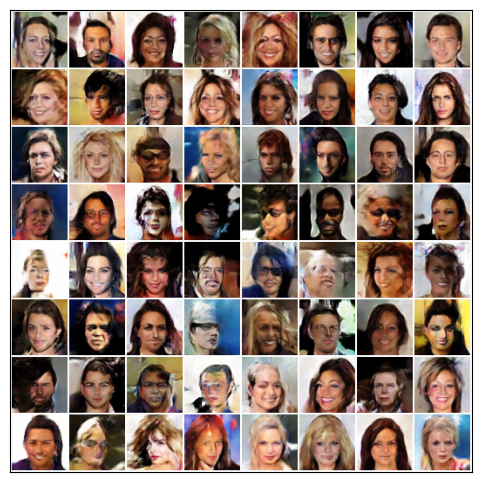

-------------------------------------
                Epoch 5: Step: 400 |
                D_real Loss: 0.5956 | D_fake Loss: 0.1198 |
                D_total Loss: 0.7154 | G_Loss: 1.255 |
                Real_score 0.587 | Fake_score 0.109
            


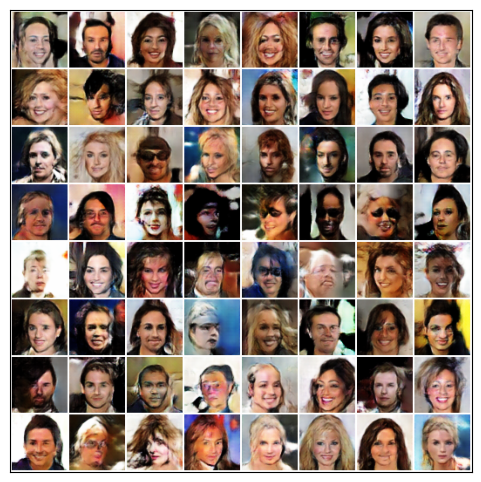

-------------------------------------
                Epoch 5: Step: 600 |
                D_real Loss: 0.2810 | D_fake Loss: 0.6427 |
                D_total Loss: 0.9237 | G_Loss: 3.751 |
                Real_score 0.778 | Fake_score 0.430
            


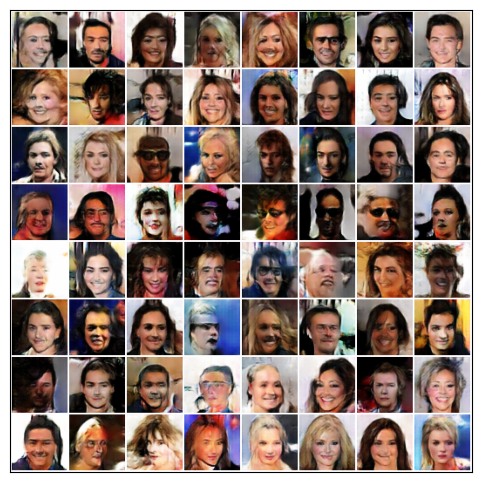

-------------------------------------
                Epoch 5: Step: 800 |
                D_real Loss: 0.4528 | D_fake Loss: 0.1175 |
                D_total Loss: 0.5703 | G_Loss: 1.627 |
                Real_score 0.667 | Fake_score 0.107
            


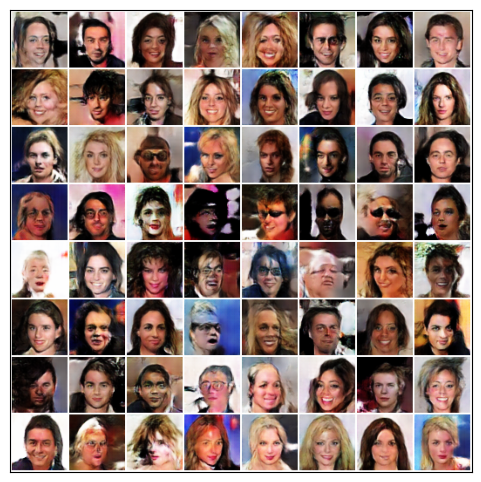

-------------------------------------
                Epoch 5: Step: 1000 |
                D_real Loss: 0.2126 | D_fake Loss: 0.9574 |
                D_total Loss: 1.1700 | G_Loss: 2.565 |
                Real_score 0.832 | Fake_score 0.534
            


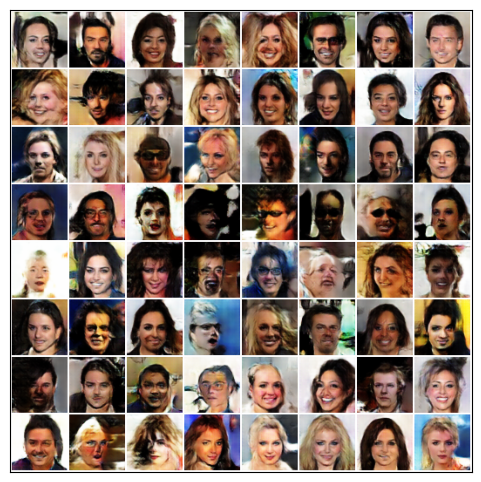

-------------------------------------
                Epoch 5: Step: 1200 |
                D_real Loss: 0.3340 | D_fake Loss: 0.1946 |
                D_total Loss: 0.5287 | G_Loss: 2.551 |
                Real_score 0.739 | Fake_score 0.168
            


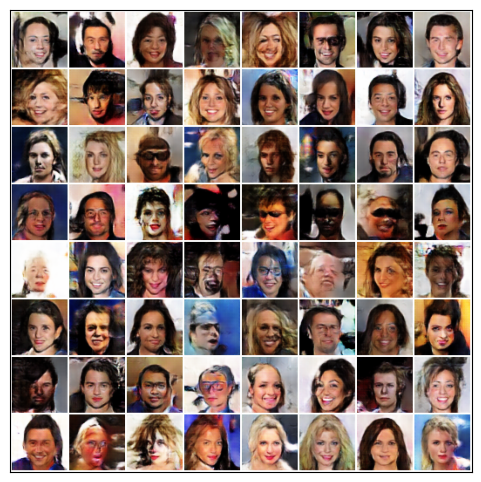

-------------------------------------
                Epoch 5: Step: 1400 |
                D_real Loss: 0.1333 | D_fake Loss: 0.3361 |
                D_total Loss: 0.4695 | G_Loss: 2.910 |
                Real_score 0.885 | Fake_score 0.265
            


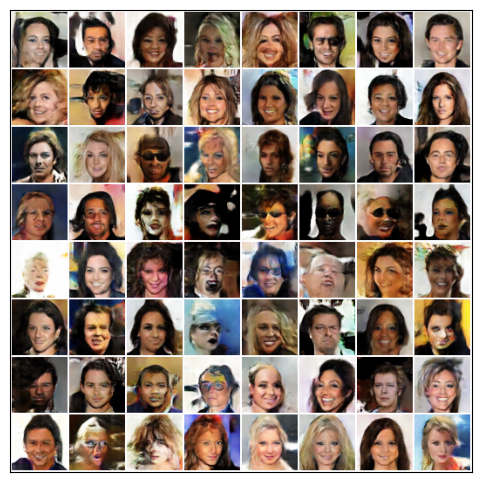

 62%|██████▎   | 5/8 [29:00<17:23, 347.79s/it]

-------------------------------------
                Epoch 6: Step: 0 |
                D_real Loss: 0.1717 | D_fake Loss: 0.3720 |
                D_total Loss: 0.5437 | G_Loss: 2.725 |
                Real_score 0.853 | Fake_score 0.285
            


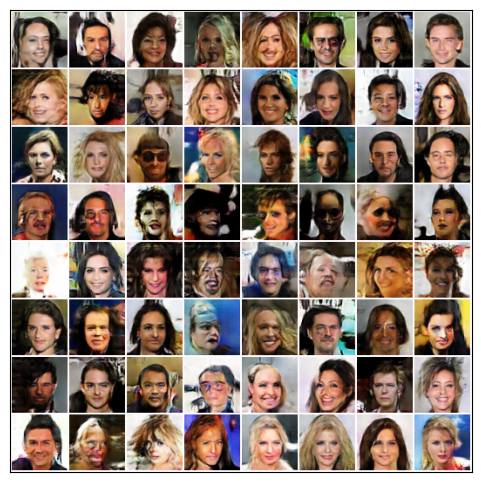

-------------------------------------
                Epoch 6: Step: 200 |
                D_real Loss: 1.3763 | D_fake Loss: 0.1406 |
                D_total Loss: 1.5169 | G_Loss: 0.937 |
                Real_score 0.339 | Fake_score 0.125
            


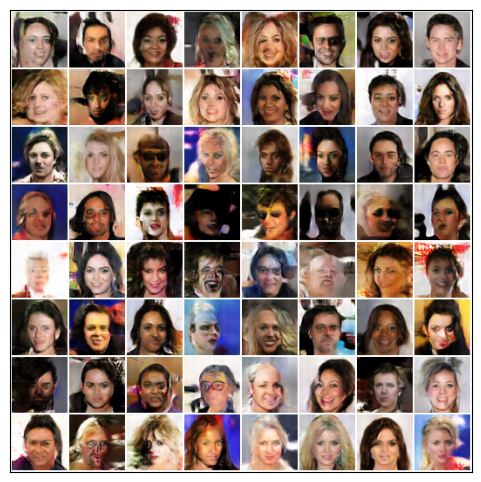

-------------------------------------
                Epoch 6: Step: 400 |
                D_real Loss: 0.1061 | D_fake Loss: 0.4554 |
                D_total Loss: 0.5615 | G_Loss: 3.653 |
                Real_score 0.905 | Fake_score 0.338
            


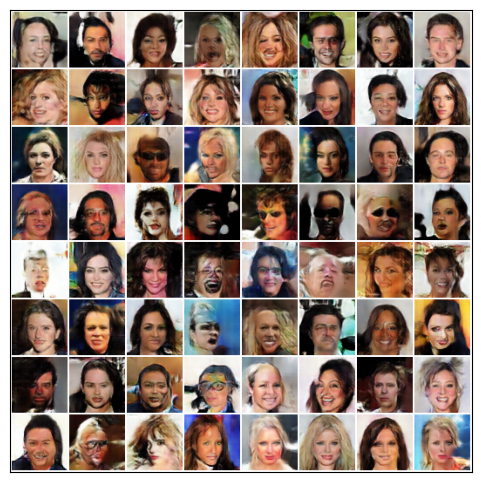

-------------------------------------
                Epoch 6: Step: 600 |
                D_real Loss: 0.1822 | D_fake Loss: 0.2832 |
                D_total Loss: 0.4654 | G_Loss: 2.553 |
                Real_score 0.840 | Fake_score 0.230
            


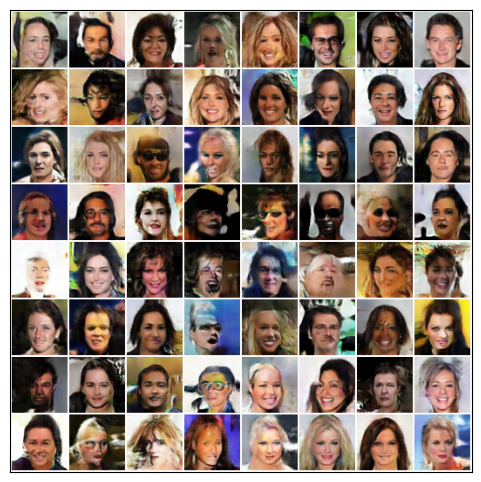

-------------------------------------
                Epoch 6: Step: 800 |
                D_real Loss: 0.1973 | D_fake Loss: 0.1616 |
                D_total Loss: 0.3589 | G_Loss: 2.546 |
                Real_score 0.830 | Fake_score 0.137
            


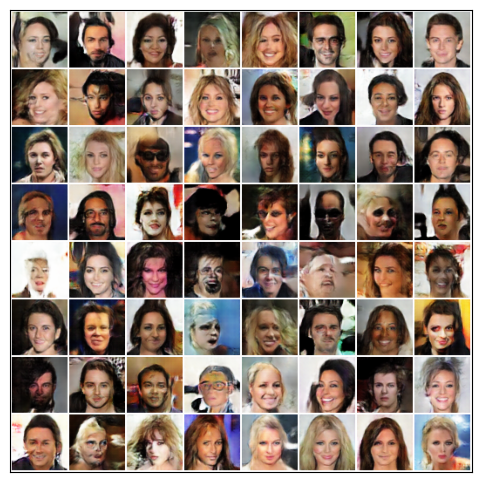

-------------------------------------
                Epoch 6: Step: 1000 |
                D_real Loss: 0.1431 | D_fake Loss: 0.4310 |
                D_total Loss: 0.5741 | G_Loss: 3.402 |
                Real_score 0.876 | Fake_score 0.320
            


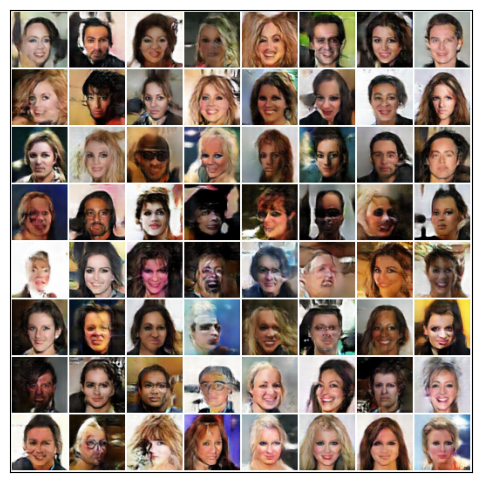

-------------------------------------
                Epoch 6: Step: 1200 |
                D_real Loss: 0.2868 | D_fake Loss: 0.2598 |
                D_total Loss: 0.5466 | G_Loss: 2.158 |
                Real_score 0.773 | Fake_score 0.212
            


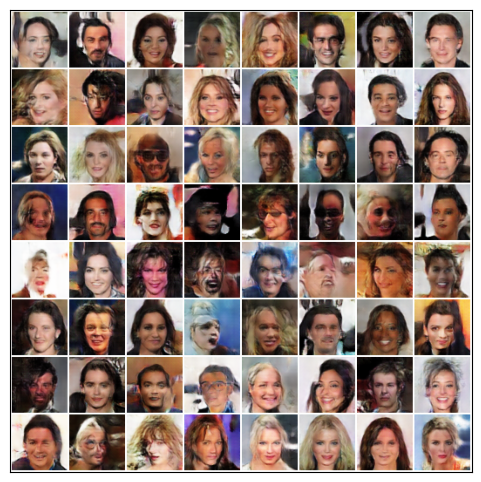

-------------------------------------
                Epoch 6: Step: 1400 |
                D_real Loss: 0.1700 | D_fake Loss: 0.2813 |
                D_total Loss: 0.4513 | G_Loss: 2.494 |
                Real_score 0.853 | Fake_score 0.228
            


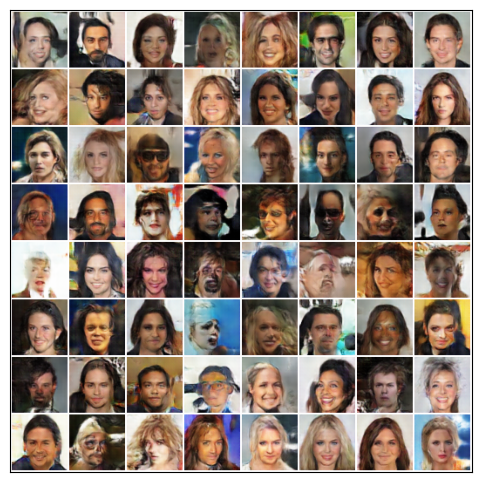

 75%|███████▌  | 6/8 [34:47<11:34, 347.36s/it]

-------------------------------------
                Epoch 7: Step: 0 |
                D_real Loss: 0.5200 | D_fake Loss: 0.1168 |
                D_total Loss: 0.6369 | G_Loss: 2.725 |
                Real_score 0.639 | Fake_score 0.104
            


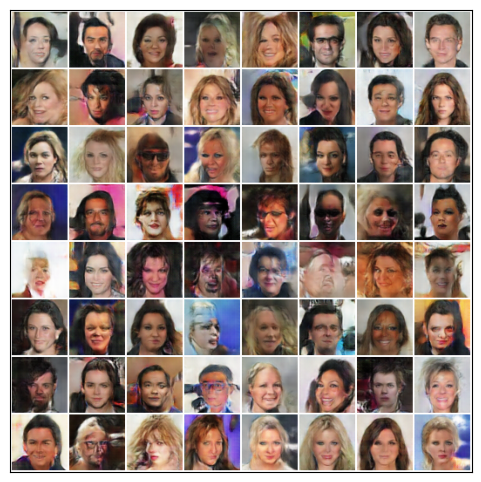

-------------------------------------
                Epoch 7: Step: 200 |
                D_real Loss: 0.1686 | D_fake Loss: 0.3236 |
                D_total Loss: 0.4923 | G_Loss: 3.435 |
                Real_score 0.854 | Fake_score 0.257
            


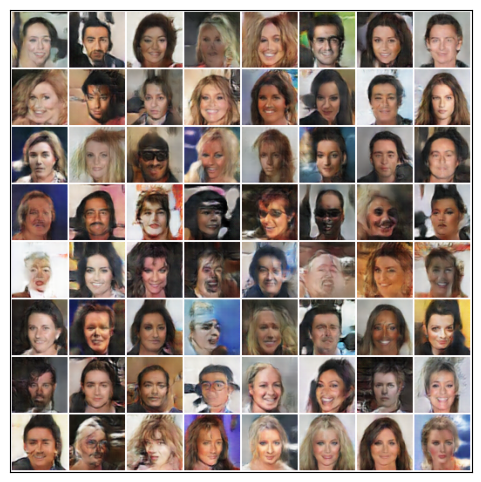

-------------------------------------
                Epoch 7: Step: 400 |
                D_real Loss: 0.2131 | D_fake Loss: 0.2353 |
                D_total Loss: 0.4484 | G_Loss: 2.124 |
                Real_score 0.819 | Fake_score 0.195
            


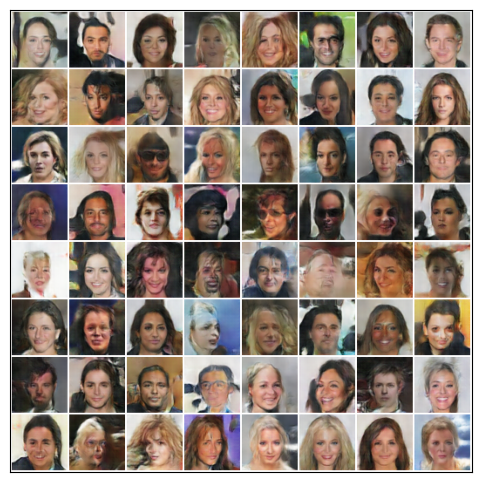

-------------------------------------
                Epoch 7: Step: 600 |
                D_real Loss: 1.0400 | D_fake Loss: 0.0492 |
                D_total Loss: 1.0891 | G_Loss: 0.970 |
                Real_score 0.416 | Fake_score 0.047
            


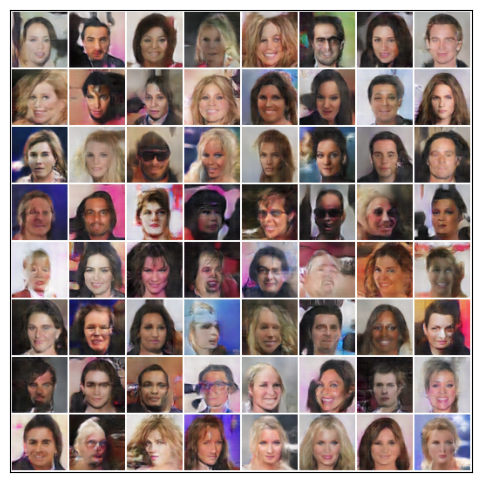

-------------------------------------
                Epoch 7: Step: 800 |
                D_real Loss: 0.2614 | D_fake Loss: 0.2146 |
                D_total Loss: 0.4760 | G_Loss: 2.531 |
                Real_score 0.788 | Fake_score 0.178
            


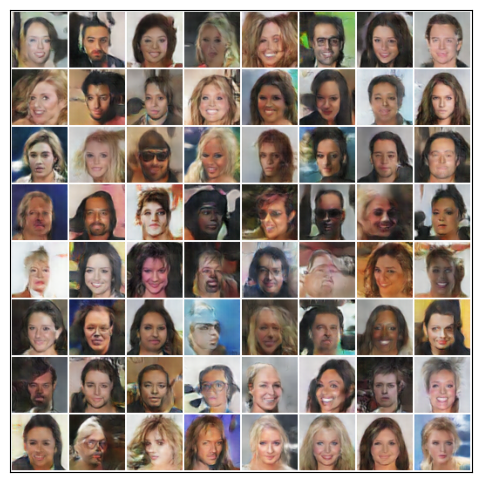

-------------------------------------
                Epoch 7: Step: 1000 |
                D_real Loss: 1.0430 | D_fake Loss: 0.0340 |
                D_total Loss: 1.0770 | G_Loss: 0.850 |
                Real_score 0.413 | Fake_score 0.033
            


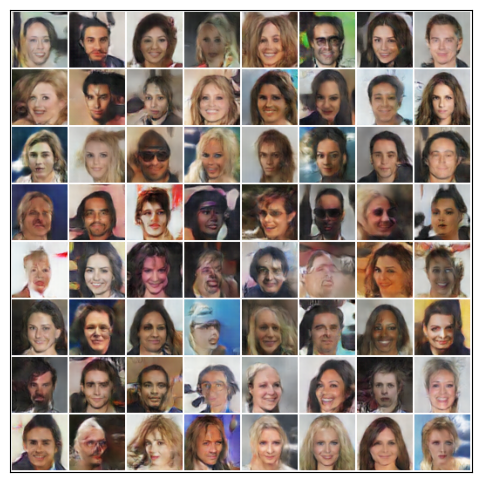

-------------------------------------
                Epoch 7: Step: 1200 |
                D_real Loss: 0.5752 | D_fake Loss: 0.0909 |
                D_total Loss: 0.6661 | G_Loss: 1.934 |
                Real_score 0.609 | Fake_score 0.083
            


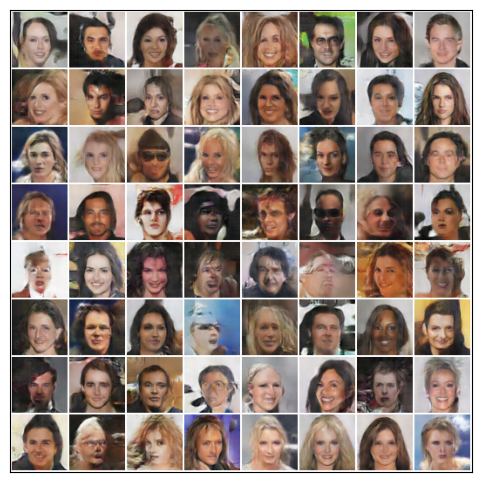

-------------------------------------
                Epoch 7: Step: 1400 |
                D_real Loss: 0.3415 | D_fake Loss: 0.1099 |
                D_total Loss: 0.4514 | G_Loss: 2.014 |
                Real_score 0.733 | Fake_score 0.100
            


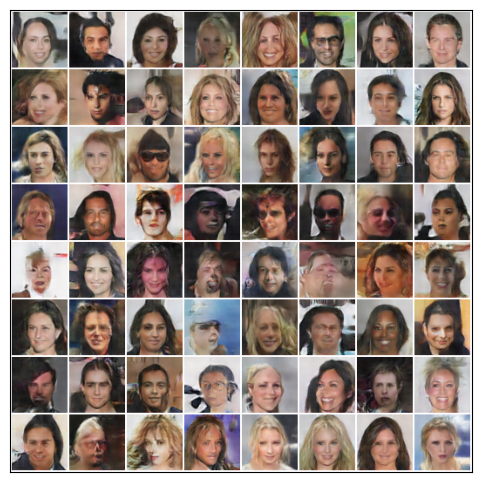

 88%|████████▊ | 7/8 [40:34<05:47, 347.37s/it]

-------------------------------------
                Epoch 8: Step: 0 |
                D_real Loss: 0.0615 | D_fake Loss: 0.4620 |
                D_total Loss: 0.5235 | G_Loss: 3.849 |
                Real_score 0.942 | Fake_score 0.339
            


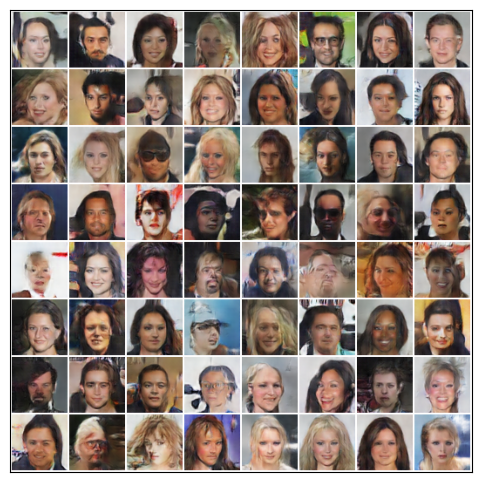

-------------------------------------
                Epoch 8: Step: 200 |
                D_real Loss: 0.0382 | D_fake Loss: 0.7441 |
                D_total Loss: 0.7823 | G_Loss: 5.005 |
                Real_score 0.963 | Fake_score 0.478
            


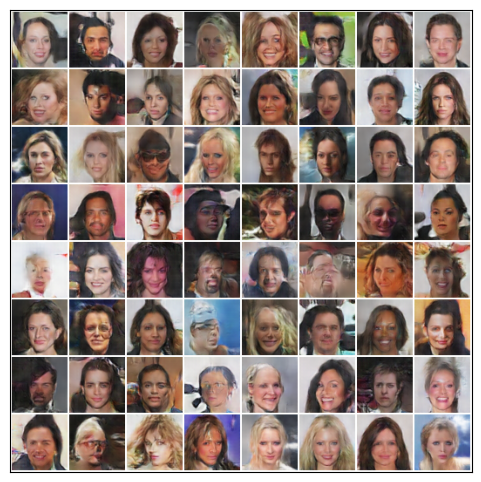

-------------------------------------
                Epoch 8: Step: 400 |
                D_real Loss: 2.1342 | D_fake Loss: 0.0427 |
                D_total Loss: 2.1769 | G_Loss: 1.137 |
                Real_score 0.196 | Fake_score 0.040
            


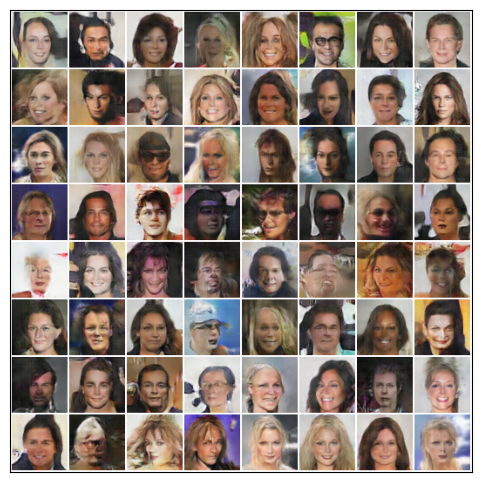

-------------------------------------
                Epoch 8: Step: 600 |
                D_real Loss: 0.1637 | D_fake Loss: 0.1992 |
                D_total Loss: 0.3629 | G_Loss: 2.914 |
                Real_score 0.861 | Fake_score 0.164
            


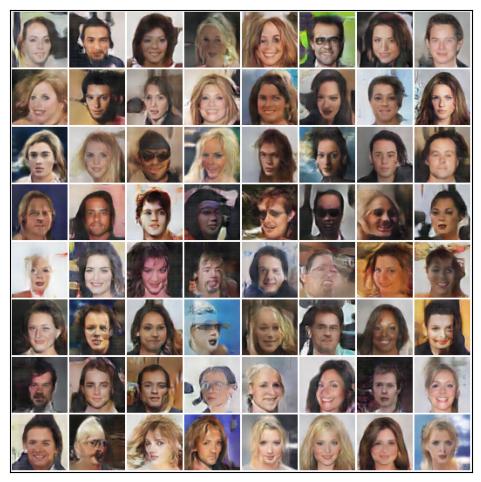

-------------------------------------
                Epoch 8: Step: 800 |
                D_real Loss: 0.1271 | D_fake Loss: 0.3546 |
                D_total Loss: 0.4818 | G_Loss: 3.020 |
                Real_score 0.888 | Fake_score 0.267
            


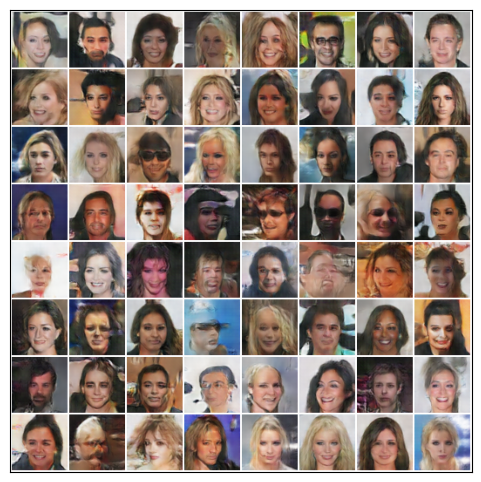

-------------------------------------
                Epoch 8: Step: 1000 |
                D_real Loss: 0.3444 | D_fake Loss: 0.4164 |
                D_total Loss: 0.7608 | G_Loss: 2.333 |
                Real_score 0.747 | Fake_score 0.287
            


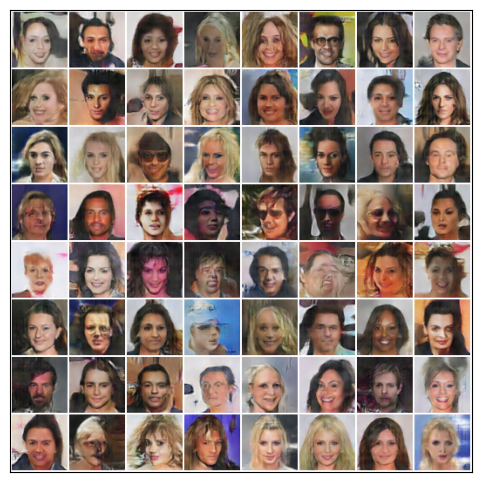

-------------------------------------
                Epoch 8: Step: 1200 |
                D_real Loss: 0.0837 | D_fake Loss: 1.1976 |
                D_total Loss: 1.2813 | G_Loss: 4.493 |
                Real_score 0.924 | Fake_score 0.618
            


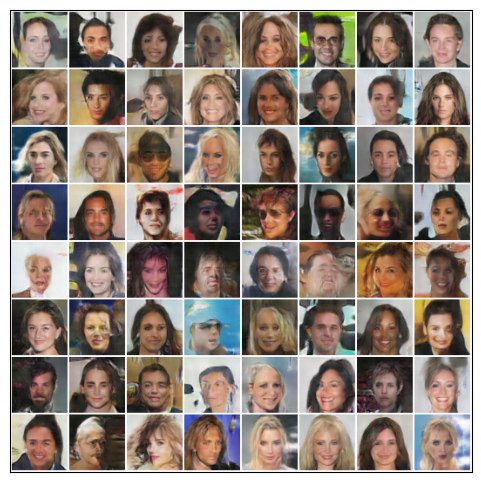

-------------------------------------
                Epoch 8: Step: 1400 |
                D_real Loss: 0.7276 | D_fake Loss: 0.0889 |
                D_total Loss: 0.8164 | G_Loss: 0.945 |
                Real_score 0.548 | Fake_score 0.082
            


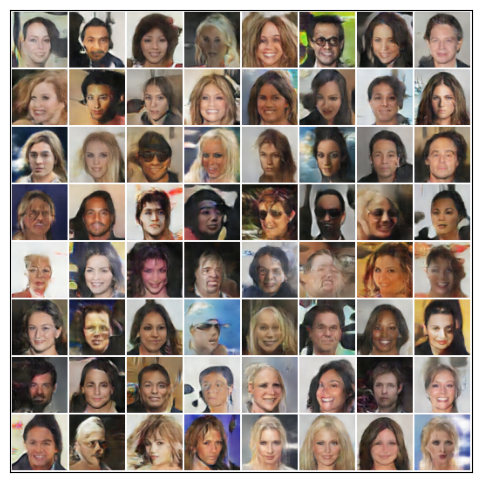

-------------------------------------
                Epoch 8: Step: 1581 |
                D_real Loss: 1.1826 | D_fake Loss: 0.0146 |
                D_total Loss: 1.1973 | G_Loss: 0.208 |
                Real_score 0.367 | Fake_score 0.014
            


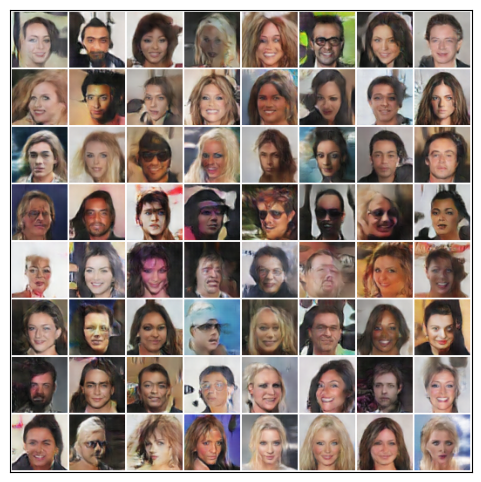

100%|██████████| 8/8 [46:22<00:00, 347.86s/it]


In [17]:
G_losses = []
D_losses = []

real_score_list = []
fake_score_list = []

for epoch in tqdm(range(num_epochs)):
    for i, (data, _) in enumerate(train_dl, 0):

        netD.zero_grad()

        real_images = data.to(device)

        # Feed real images through discriminator
        output = netD(real_images).view(-1)

        # Calculate loss on real images by comparing with real labels
        real_loss_D = criterion(output, real_image_labels)

        # Compute discriminator gradients
        real_loss_D.backward()

        real_score_D = output.mean().item()

        # Generate fake image batch with generator
        noise = torch.randn(batch_size, nz, 1, 1,device = device)

        fake_images = netG(noise)

        # Classify all fake batch with D
        output = netD(fake_images.detach()).view(-1)

        # Calculate loss on fake images by comparing with fake labels
        fake_loss_D = criterion(output, fake_image_labels)

        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        fake_loss_D.backward()

        fake_score_D = output.mean().item()

        # Compute error of discriminator as sum over the fake and the real batches
        total_loss_D = real_loss_D + fake_loss_D

        # Update discriminator parameters
        optimizer_d.step()


        netG.zero_grad()

        # Feed fake images through discriminator with newly updated weights
        output = netD(fake_images).view(-1)

        # Calculate generator's loss based on this output
        loss_G = criterion(output, real_image_labels)

        # Calculate gradients for generator
        loss_G.backward()

        # Update generator parameters
        optimizer_g.step()

        if i % 200 == 0 or ((epoch == num_epochs - 1) and (i == len(train_dl) - 1)):
            print(f"""-------------------------------------
                Epoch {epoch + 1}: Step: {i} |
                D_real Loss: {real_loss_D:.4f} | D_fake Loss: {fake_loss_D:.4f} |
                D_total Loss: {total_loss_D:.4f} | G_Loss: {loss_G:.3f} |
                Real_score {real_score_D:.3f} | Fake_score {fake_score_D:.3f}
            """)
            with torch.no_grad():
              fake = netG(fixed_noise).detach().cpu()
              display(make_grid(fake, nrow = 8, pad_value = 1.0))

        G_losses.append(loss_G.item())
        D_losses.append(total_loss_D.item())

        real_score_list.append(real_score_D)
        fake_score_list.append(fake_score_D)



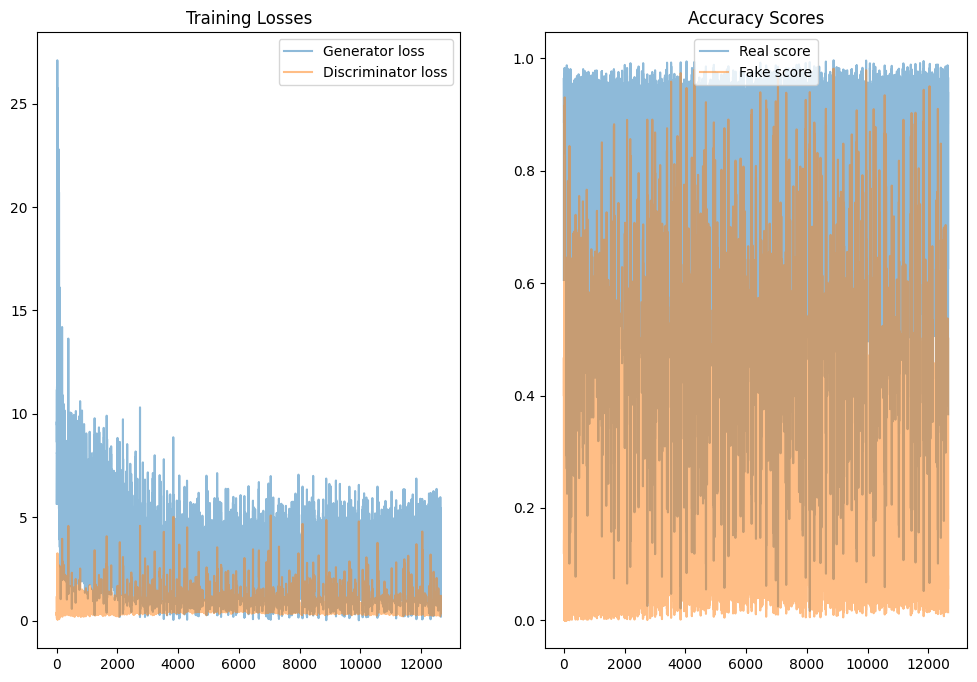

In [18]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (12, 8))

ax1.plot(G_losses, label = 'Generator loss', alpha = 0.5)
ax1.plot(D_losses, label = 'Discriminator loss', alpha = 0.5)
ax1.legend()

ax1.set_title('Training Losses')
ax2.plot(real_score_list, label = 'Real score', alpha = 0.5)
ax2.plot(fake_score_list, label = 'Fake score', alpha = 0.5)
ax2.set_title('Accuracy Scores')

ax2.legend()